# Olist E-Commerce - Customer Behavior Analysis

This project explores customer behavior, purchase frequency, and sales performance using the Olist Brazilian E-Commerce dataset sourced from Kaggle.com ([Link](https://www.kaggle.com/datasets/terencicp/e-commerce-dataset-by-olist-as-an-sqlite-database)). The goal is to uncover patterns that can drive business decisions such as customer segmentation, product optimization, and marketing strategies.

### Objectives
- Analyze sales trends by product category over time.
- Compute average delivery times and assess their impact on customer satisfaction (via review scores).
- Perform RFM (Recency, Frequency, Monetary) segmentation to identify key customer groups.
- Calculate customer order frequency and average time between purchases.

### Key Techniques
- SQL for data extraction and transformation (joining orders, customers, and items tables).
- Python (Pandas, Matplotlib, Seaborn) for aggregation, visualization, and segmentation analysis.
- Window functions for calculating recency and purchase intervals.

### Highlights & Results
- Identified top-performing product categories by monthly revenue.
- Found that delivery delays correlate with lower review scores, highlighting operational bottlenecks.
- Built an RFM model to segment customers into actionable groups such as “Champions” and “At Risk,” enabling targeted retention strategies.
- Visualized purchase frequency distribution, revealing that most customers purchase only once, but loyal segments significantly increase lifetime value.

---

Setup

In [2]:
import sqlite3
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
db_path = "C:\\Users\\parke\\Documents\\Projects\\SQLProject\\SQLdata\\olist.sqlite"
db_connection = sqlite3.connect(db_path)

---

### In this section, we take a look at all of our table names in our schema and create a function to easily view a table

In [4]:
all_tables = """
SELECT name
FROM sqlite_master
WHERE type='table'
"""

pd.read_sql_query(all_tables, db_connection)

,name
0,product_category_name_translation
1,sellers
2,customers
3,geolocation
4,order_items
5,order_payments
6,order_reviews
7,orders
8,products
9,leads_qualified


In [5]:
def view_table(table_name, limit=5):
    query = f"SELECT * FROM {table_name} LIMIT {limit};"
    return pd.read_sql_query(query, db_connection)    

In [6]:
view_table("geolocation")

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP


In [7]:
view_table("customers")

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


---

### Now, we use our data to find out what areas most customers reside in and use the folium package to visualize it.

In [8]:
customer_locations = """SELECT
    customer_zip_code_prefix AS zip_code,
    COUNT(DISTINCT customer_unique_id) AS customer_count,
    geolocation_lat AS latitude,
    geolocation_lng AS longitude
FROM customers
JOIN geolocation ON geolocation.geolocation_zip_code_prefix = customers.customer_zip_code_prefix
GROUP BY customer_zip_code_prefix
"""

customer_loc = pd.read_sql_query(customer_locations, db_connection)

In [9]:
import folium

map = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)
for _, row in customer_loc.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=row['customer_count'] / 10,  # Adjust size for visibility
        color=None,
        fill=True,
        fill_color='red',
        fill_opacity=0.4,
        popup=f"Zip Code: {row['zip_code']}, Customers: {row['customer_count']}"
    ).add_to(map)
map

This visualization highlights the geographic distribution of customers, allowing us to identify regions with the highest concentration of orders. These insights can guide strategic decisions regarding resource allocation, staffing, and delivery planning to optimize efficiency in high-demand areas.

---

### In this Section, we take a look at product sales by category and visualize the most popular product categories by sales.

In [18]:
product_sales_query = """SELECT
    product_category_name_english as category,
    SUM(payment_value) AS total_sales,
    COUNT(order_id) AS order_count,
    strftime('%Y-%m', order_purchase_timestamp) AS purchase_date
    
    FROM order_items
    JOIN products USING (product_id)
    JOIN product_category_name_translation USING (product_category_name)
    JOIN orders USING (order_id)
    JOIN order_payments USING (order_id)
    GROUP BY purchase_date, category
    ORDER BY purchase_date, total_sales DESC
"""

product_sales = pd.read_sql_query(product_sales_query, db_connection)
product_sales

,category,total_sales,order_count,purchase_date
0,furniture_decor,272.46,2,2016-09
1,telephony,75.06,1,2016-09
2,furniture_decor,10852.54,75,2016-10
3,perfumery,7201.84,36,2016-10
4,health_beauty,6062.16,50,2016-10
...,...,...,...,...
1247,diapers_and_hygiene,276.93,3,2018-08
1248,fashion_underwear_beach,246.76,2,2018-08
1249,fashion_sport,83.05,1,2018-08
1250,dvds_blu_ray,16.29,1,2018-08


In [44]:
top_categories = product_sales.groupby('category')['total_sales'].sum().nlargest(5).index
top_df = product_sales[product_sales['category'].isin(top_categories)]

top_count = product_sales.groupby('category')['order_count'].sum().nlargest(5).index
top_count_df = product_sales[product_sales['category'].isin(top_count)]

In [45]:
pivot_df1 = top_df.pivot(index='purchase_date', columns='category', values='total_sales').fillna(0)
pivot_df2 = top_count_df.pivot(index='purchase_date', columns='category', values='order_count').fillna(0)

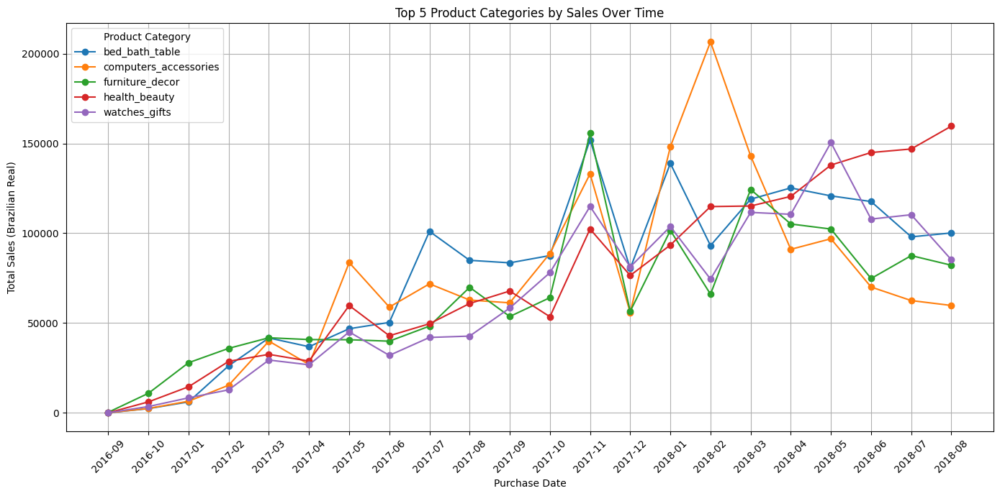

In [ ]:
plt.figure(figsize=(14, 7))

for category in pivot_df1.columns:
    plt.plot(pivot_df1.index, pivot_df1[category], marker='o', label=category)

plt.title('Top 5 Product Categories by Sales Over Time')
plt.xlabel('Purchase Date')
plt.ylabel('Total Sales (Brazilian Real)')
plt.xticks(rotation=45)
plt.legend(title='Product Category', loc='upper left')
plt.tight_layout()
plt.grid(True)
plt.show()


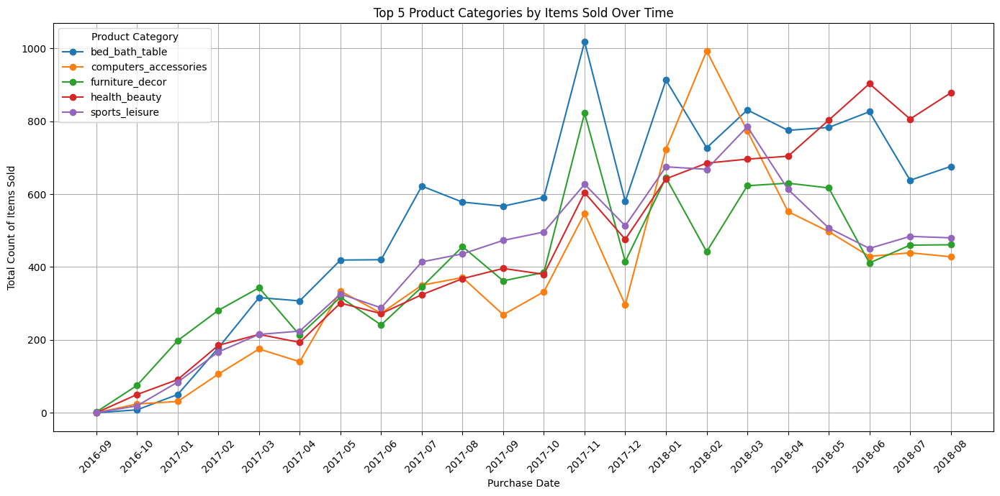

In [35]:
plt.figure(figsize=(14, 7))

for category in pivot_df2.columns:
    plt.plot(pivot_df2.index, pivot_df2[category], marker='o', label=category)



plt.title('Top 5 Product Categories by Items Sold Over Time')
plt.xlabel('Purchase Date')
plt.ylabel('Total Count of Items Sold')
plt.xticks(rotation=45)
plt.legend(title='Product Category', loc='upper left')
plt.tight_layout()
plt.grid(True)
plt.show()

Both of these visualizations show a positive trend in sales between the years 2016 and 2018. Some interesting details include the sharp spike in computer accessories from 2017-12 to 2018-02 which unfortunately, due to the limitations of the data, we are unable to figure out the actual items that were sold to understand better why this might be.

---

### Next, we take a look at reviews to find any potential problems with the products.

In [6]:
review_query = """SELECT
    review_score,
    COUNT(*) as review_count
FROM order_reviews
GROUP BY review_score
"""

review_dist = pd.read_sql_query(review_query, db_connection)

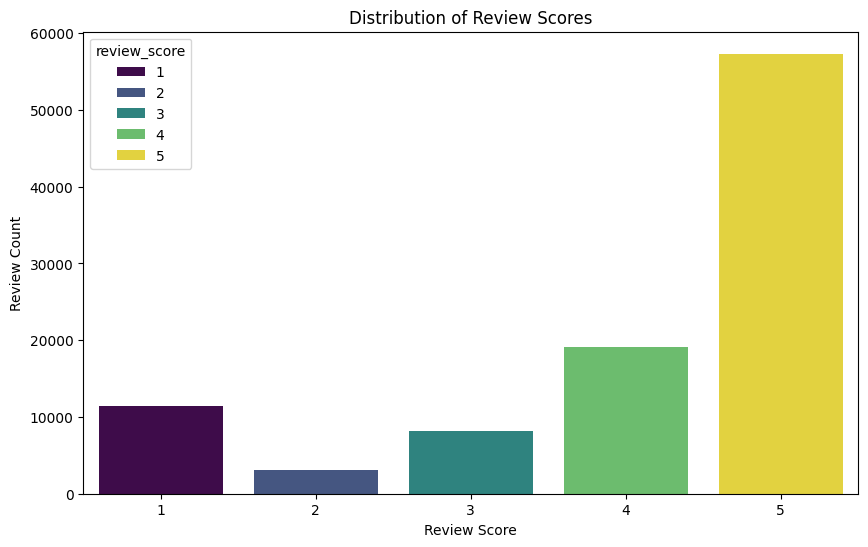

In [ ]:
plt.figure(figsize=(10, 6))
sns.barplot(x='review_score', y='review_count', data=review_dist, hue='review_score', palette='viridis')
plt.title('Distribution of Review Scores')
plt.xlabel('Review Score')
plt.ylabel('Review Count')

plt.show()

In [13]:
review_words_neg = """SELECT 
    GROUP_CONCAT(review_comment_message, ' ') AS all_reviews
    FROM order_reviews
    WHERE review_score IN (1,2)    
"""

review_words_pos = """SELECT 
    GROUP_CONCAT(review_comment_message, ' ') AS all_reviews
    FROM order_reviews
    WHERE review_score IN (4,5)    
"""

neg_reviews = pd.read_sql_query(review_words_neg, db_connection)
pos_reviews = pd.read_sql_query(review_words_pos, db_connection)


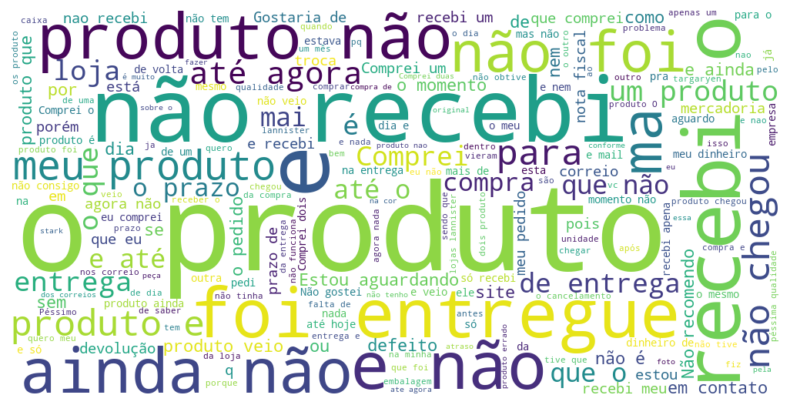

In [15]:
from wordcloud import WordCloud

wordcloud = WordCloud(width=1000, height=500, background_color='white').generate(neg_reviews['all_reviews'].iloc[0])
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

Now because I am not fluent whatsoever in Brazilian, using a bit of Google Translate, we figure out that the more common words/phrases of these negative comments are things like 'I didn't recieve', "delivered", and "didn't arrive." Which likely means that the vast majority of negative comments are due to delayed shipping times or even none-delivered products. Now we can take a look at the delivery times based on comments to see if there is any correlation.

In [19]:
avg_delivery_query = """SELECT 
    AVG(JULIANDAY(order_delivered_customer_date) - JULIANDAY(order_purchase_timestamp)) AS avg_delivery_time,
    review_score
    FROM orders
    JOIN order_reviews USING (order_id)
    WHERE order_delivered_customer_date IS NOT NULL
        AND review_score IS NOT NULL 
    GROUP BY review_score
"""

avg_delivery_df = pd.read_sql_query(avg_delivery_query, db_connection)

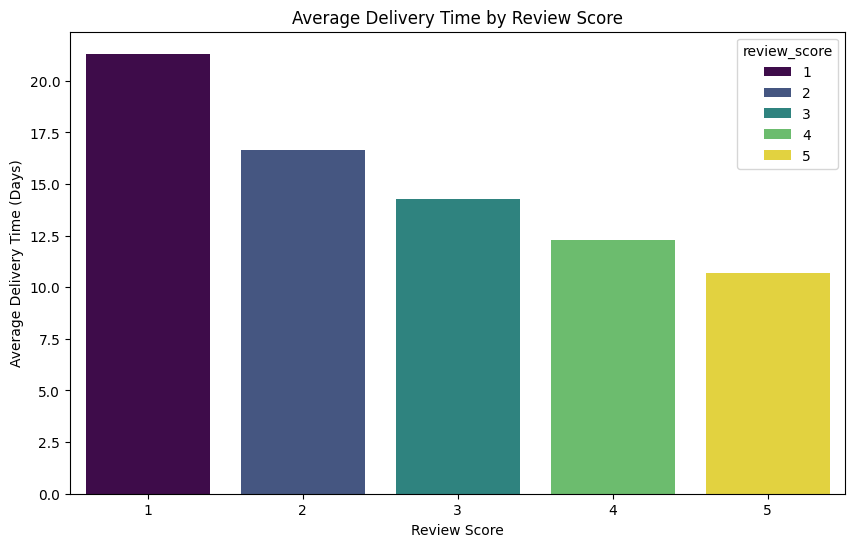

In [20]:
plt.figure(figsize=(10, 6))
sns.barplot(x='review_score', y='avg_delivery_time', data=avg_delivery_df, hue = 'review_score', palette='viridis')
plt.title('Average Delivery Time by Review Score')
plt.xlabel('Review Score')
plt.ylabel('Average Delivery Time (Days)')
plt.show()


We can definitely see a correlation between review score and delivery time where the higher average delivery times are more likely to be lower review scores which is supported by our wordcloud of reviews.

---

### Finally, we do some RFM (Recency, Frequency, Monetary) Segmentation

First just to get an understanding of the data, we find the number of orders per customer, the sum of total payment by customer, and each customers average days between orders.

In [9]:
order_count_query = """SELECT
    customer_unique_id,
    COUNT(order_id) as count_orders
FROM customers
JOIN orders using (customer_id)
GROUP BY customer_unique_id
ORDER BY count_orders DESC
"""

pd.read_sql_query(order_count_query, db_connection)

,customer_unique_id,count_orders
0,8d50f5eadf50201ccdcedfb9e2ac8455,17
1,3e43e6105506432c953e165fb2acf44c,9
2,ca77025e7201e3b30c44b472ff346268,7
3,6469f99c1f9dfae7733b25662e7f1782,7
4,1b6c7548a2a1f9037c1fd3ddfed95f33,7
...,...,...
96091,0004aac84e0df4da2b147fca70cf8255,1
96092,0000f6ccb0745a6a4b88665a16c9f078,1
96093,0000f46a3911fa3c0805444483337064,1
96094,0000b849f77a49e4a4ce2b2a4ca5be3f,1


In [11]:
beeg_query = """SELECT
    customer_unique_id,
    SUM(payment_value) as total_payment
FROM customers
JOIN orders USING (customer_id)
JOIN order_payments USING (order_id)
GROUP BY customer_unique_id
ORDER BY SUM(payment_value) DESC
"""

pd.read_sql_query(beeg_query, db_connection)

,customer_unique_id,total_payment
0,0a0a92112bd4c708ca5fde585afaa872,13664.08
1,46450c74a0d8c5ca9395da1daac6c120,9553.02
2,da122df9eeddfedc1dc1f5349a1a690c,7571.63
3,763c8b1c9c68a0229c42c9fc6f662b93,7274.88
4,dc4802a71eae9be1dd28f5d788ceb526,6929.31
...,...,...
96090,b33336f46234b24a613ad9064d13106d,10.89
96091,bd06ce0e06ad77a7f681f1a4960a3cc6,10.07
96092,317cfc692e3f86c45c95697c61c853a6,9.59
96093,968fac81e2c44fb6c1e3ac2a45e6a102,0.00


In [15]:
avg_order_value_query = f"""SELECT
    MIN(total_payment) AS min_order_value,
    MAX(total_payment) AS max_order_value,
    AVG(total_payment) AS avg_order_value
    FROM ({beeg_query})
    WHERE total_payment > 0"""
    
pd.read_sql_query(avg_order_value_query, db_connection)

,min_order_value,max_order_value,avg_order_value
0,9.59,13664.08,166.597693


In [ ]:
frequency_query = """WITH
order_lags AS (
    SELECT
        customer_unique_id,
        order_id,
        order_purchase_timestamp,
        julianday(order_purchase_timestamp) - julianday(
            LAG(order_purchase_timestamp) 
            OVER (PARTITION BY customer_unique_id ORDER BY order_purchase_timestamp)
        ) AS days_since_last_order
    FROM orders
    JOIN customers USING (customer_id)            
)
SELECT 
    customer_unique_id,
    COUNT(order_id) AS order_count,
    AVG(days_since_last_order) AS avg_days_between_orders
FROM order_lags
GROUP BY customer_unique_id
HAVING COUNT(order_id) > 1
ORDER BY avg_days_between_orders DESC
"""
    
pd.read_sql_query(frequency_query, db_connection)

,customer_unique_id,order_count,avg_days_between_orders
0,ccafc1c3f270410521c3c6f3b249870f,2,608.978912
1,d8f3c4f441a9b59a29f977df16724f38,2,582.864363
2,94e5ea5a8c1bf546db2739673060c43f,2,580.693322
3,87b3f231705783eb2217e25851c0a45d,2,572.686840
4,4e23e1826902ec9f208e8cc61329b494,2,524.413495
...,...,...,...
2992,07df27b714016cb827c99ec2ecd5ebfb,2,0.000000
2993,0710e0c85fe7cb494d624e0863782e46,2,0.000000
2994,050555c26479bbb8ba0740c37e7454d0,2,0.000000
2995,031e19fc630c4121f1238716f41675c3,2,0.000000


In [4]:
rfm_query = """
SELECT 
    c.customer_unique_id,
    MAX(o.order_purchase_timestamp) AS last_purchase,
    COUNT(o.order_id) AS frequency,
    SUM(oi.price) AS monetary
FROM orders o
JOIN customers c USING (customer_id)
JOIN order_items oi USING (order_id)
WHERE o.order_status = 'delivered'
GROUP BY c.customer_unique_id
"""
rfm_df = pd.read_sql(rfm_query, db_connection)
rfm_df


,customer_unique_id,last_purchase,frequency,monetary
0,0000366f3b9a7992bf8c76cfdf3221e2,2018-05-10 10:56:27,1,129.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,2018-05-07 11:11:27,1,18.90
2,0000f46a3911fa3c0805444483337064,2017-03-10 21:05:03,1,69.00
3,0000f6ccb0745a6a4b88665a16c9f078,2017-10-12 20:29:41,1,25.99
4,0004aac84e0df4da2b147fca70cf8255,2017-11-14 19:45:42,1,180.00
...,...,...,...,...
93353,fffcf5a5ff07b0908bd4e2dbc735a684,2017-06-08 21:00:36,2,1570.00
93354,fffea47cd6d3cc0a88bd621562a9d061,2017-12-10 20:07:56,1,64.89
93355,ffff371b4d645b6ecea244b27531430a,2017-02-07 15:49:16,1,89.90
93356,ffff5962728ec6157033ef9805bacc48,2018-05-02 15:17:41,1,115.00


In [24]:
from datetime import datetime

# Convert date
rfm_df['last_purchase'] = pd.to_datetime(rfm_df['last_purchase'])

# Today's date (or latest date in dataset)
snapshot_date = rfm_df['last_purchase'].max() + pd.Timedelta(days=1)

# Recency in days
rfm_df['recency'] = (snapshot_date - rfm_df['last_purchase']).dt.days

# Use quantiles to assign scores (1 to 5)
rfm_df['r_score'] = pd.qcut(rfm_df['recency'], 5, labels=[5,4,3,2,1]).astype(int)
rfm_df['f_score'] = pd.qcut(rfm_df['frequency'].rank(method='first'), 5, labels=[5,4,3,2,1]).astype(int)
rfm_df['m_score'] = pd.qcut(rfm_df['monetary'], 5, labels=[5,4,3,2,1]).astype(int)


Lower recency should be better
frequency + monetary lower than 5 

In [25]:
rfm_df.sort_values(['f_score'])[30000:]

,customer_unique_id,last_purchase,frequency,monetary,recency,r_score,f_score,m_score,rfm_score,RFM_Bucket
66987,b77d9287064d0c8130947b0c84166a76,2017-01-26 13:32:04,1,689.89,581,1,2,1,14,Price Sensitive
66988,b77dd405fa333bef432fd3b269566ebd,2017-07-18 09:06:50,1,99.99,408,1,2,3,12,Recent Users
66972,b77776eae6a9ee05aeeaf60842656d26,2018-05-05 23:10:33,1,142.90,116,4,2,2,10,Lost
66973,b778721e39088e17ff825a3f74946398,2018-01-05 21:29:54,1,69.90,236,3,2,4,9,Needs Attention
66974,b778c913f1aeb04dfcb4d342833c22a8,2018-01-16 14:12:13,1,122.99,226,3,2,2,11,About to Sleep
...,...,...,...,...,...,...,...,...,...,...
2,0000f46a3911fa3c0805444483337064,2017-03-10 21:05:03,1,69.00,537,1,5,4,8,Champions
1,0000b849f77a49e4a4ce2b2a4ca5be3f,2018-05-07 11:11:27,1,18.90,115,4,5,5,4,Can't Lose Them
0,0000366f3b9a7992bf8c76cfdf3221e2,2018-05-10 10:56:27,1,129.90,112,4,5,2,7,Hibernating
31,0014a5a58da615f7b01a4f5e194bf5ea,2018-01-18 20:49:36,1,88.00,223,3,5,3,7,Loyal Customers


In [26]:
# You can combine scores if needed
rfm_df['rfm_score'] = rfm_df['r_score'] + rfm_df['f_score'] + rfm_df['m_score']

# Define your buckets
def classify_customer(row):
    r, f, m = row['r_score'], row['f_score'], row['m_score']
    score_sum = f + m
    if r == 5 and score_sum <= 4:
        return "Champions"
    elif r in [1,2] and score_sum <= 2:
        return "Can't Lose Them"
    elif r in [1,2] and score_sum in [3,4,5,6]:
        return "Hibernating"
    elif r in [1,2] and score_sum >= 7:
        return "Lost"
    elif r in [3,4] and score_sum <= 4:
        return "Loyal Customers"
    elif r == 3 and score_sum in [5,6]:
        return "Needs Attention"
    elif r == 5 and score_sum in [7,8]:
        return "Recent Users"
    elif (r == 5 and score_sum in [5,6]) or (r == 4 and score_sum in [5,6,7,8]):
        return "Potential Loyalists"
    elif r == 5 and score_sum >= 9:
        return "Price Sensitive"
    elif r == 4 and score_sum >= 9:
        return "Promising"
    elif r == 3 and score_sum >= 7:
        return "About to Sleep"
    else:
        return "Others"

rfm_df['RFM_Bucket'] = rfm_df.apply(classify_customer, axis=1)


In [27]:
grouped = rfm_df.groupby('RFM_Bucket').agg(
    avg_days_since_purchase=('recency', 'mean'),
    avg_sales_per_customer=('monetary', lambda x: x.sum() / len(x)),
    customer_count=('customer_unique_id', 'count')
).reset_index()


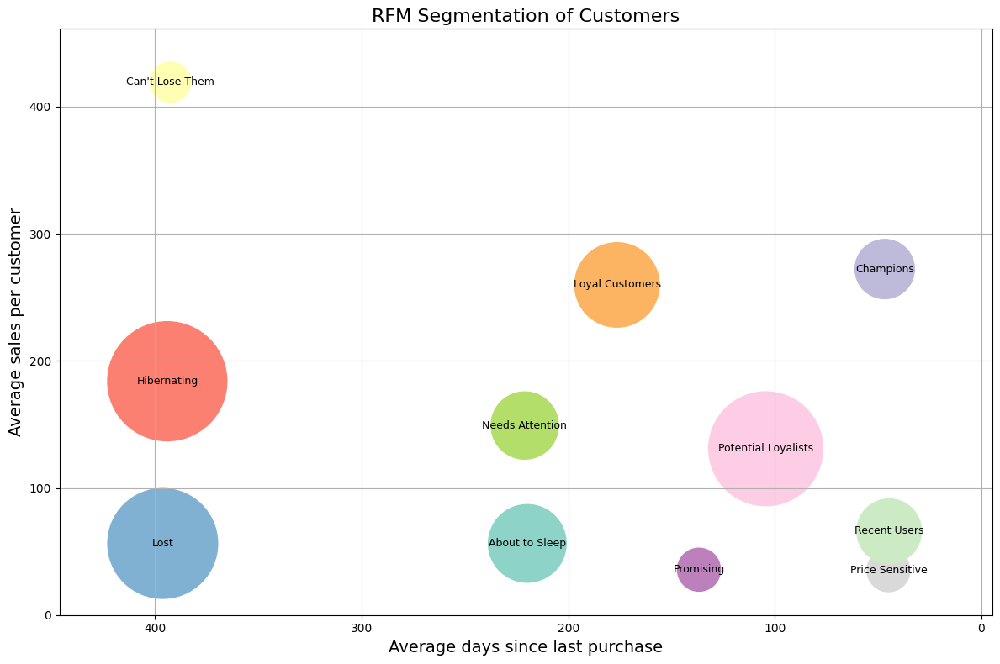

In [28]:
# Set figure size
plt.figure(figsize=(12, 8))

# Create a scatter plot
scatter = plt.scatter(
    grouped['avg_days_since_purchase'], 
    grouped['avg_sales_per_customer'],
    s=grouped['customer_count'] * 0.55,  # Bubble size
    c=sns.color_palette('Set3', len(grouped))  # Color
)

# Add axis labels and title
plt.xlabel('Average days since last purchase', fontsize=14)
plt.ylabel('Average sales per customer', fontsize=14)
plt.title('RFM Segmentation of Customers', fontsize=16)
plt.grid(True)

# Add text labels on each bubble
for i, row in grouped.iterrows():
    plt.annotate(row['RFM_Bucket'], 
                 (row['avg_days_since_purchase'], row['avg_sales_per_customer']),
                 ha='center', va='center', fontsize=9)

# Optional: reverse x-axis to show recent purchasers on the left
plt.gca().invert_xaxis()
plt.xlim(grouped['avg_days_since_purchase'].max() + 50, grouped['avg_days_since_purchase'].min() - 50)

# Optional: set Y-axis range dynamically
plt.ylim(0, grouped['avg_sales_per_customer'].max() * 1.1)

plt.tight_layout()
plt.show()


This plot shows us the visual amount of customers that fall into each category by recency of purchases and by sales. For example, the Chapions circle in the top right have high average sales as well as most recent purchases. This graph can help Olist understand where their customers lie and potential advertising techniques like notifications for groups of customers such as the needs attention and hibernating groups who have a decently high average sales per customer but haven't purchased anything in a while. 

---
## Conclusion

In this project, I conducted a comprehensive analysis of the Brazilian e-commerce dataset using SQL and Python, leveraging 8+ relational tables. The main objectives were to explore advanced SQL techniques and extract actionable business insights using python visualizations.

### Key achievements included:

Data Exploration & Visualization: Used SQL joins and aggregations to understand customer locations, order patterns, and product category performance. Visualized key trends with Matplotlib, Seaborn, and Folium.

Customer Behavior Analysis: Calculated order frequency, customer spend, and average days between purchases. Identified irregular payment behaviors and uncovered insights on zero-value transactions.

Product Sales & Category Trends: Tracked sales and item count over time for top product categories using pivot tables and time-series plots.

Customer Satisfaction: Analyzed review scores and comments. Generated word clouds to visualize sentiment and confirmed a clear correlation between delivery times and customer satisfaction.

RFM Segmentation: Performed Recency, Frequency, and Monetary scoring for each customer, classified them into meaningful segments (e.g., Champions, Hibernating, Lost), and visualized these segments in a bubble chart.

Through this project, I applied a wide range of SQL functions and window operations, developed reusable Python workflows, and uncovered meaningful patterns in customer and sales behavior. These findings could be used by Olist to improve targeted marketing, customer retention, and operational efficiency.

---